In [ ]:
import torch
import numpy as np
from torch.utils.data import DataLoader
from torchvision import datasets, transforms
import matplotlib.pyplot as plt
from scipy.ndimage import zoom
from tqdm.notebook import tqdm
from main import VitRGTS

import torch.nn as nn
from torch.optim import Adam

ModuleNotFoundError: No module named 'Vit_RGTS'

## 데이터 불러오기


In [10]:
# 1. Setup
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# 2. Data Preparation
# 사용자 정의 변환: PIL 이미지를 RGB로 변환
def convert_to_rgb(image):
    if image.mode != "RGB":
        image = image.convert("RGB")  # RGBA 또는 P 모드 이미지도 RGB로 변환
    return image

# 변환 구성
transform = transforms.Compose([
    transforms.Lambda(convert_to_rgb),  # RGB로 변환
    transforms.Resize((224, 224)),      # 크기 조정
    transforms.ToTensor(),              # 텐서로 변환
])

# Training data
train_dataset_path = "food_classification/train"
train_dataset = datasets.ImageFolder(root=train_dataset_path, transform=transform)
train_loader = DataLoader(train_dataset, batch_size=1, shuffle=True)

# Validation data
val_dataset_path = "food_classification/validation"
val_dataset = datasets.ImageFolder(root=val_dataset_path, transform=transform)
val_loader = DataLoader(val_dataset, batch_size=1, shuffle=False)

# Test data
test_dataset_path = "food_classification/test"
test_dataset = datasets.ImageFolder(root=test_dataset_path, transform=transform)
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)

## 모델 초기화

In [11]:
num_register_tokens = 4
num_epochs = 5

# 3. Model Initialization
model_with_register = VitRGTS(
    image_size=224,
    patch_size=16,
    num_classes=5,
    dim=512,
    depth=6,
    heads=8,
    mlp_dim=1024,
    num_register_tokens=num_register_tokens,
    use_register_tokens=True
).to(device)

model_without_register = VitRGTS(
    image_size=224,
    patch_size=16,
    num_classes=5,
    dim=512,
    depth=6,
    heads=8,
    mlp_dim=1024,
    use_register_tokens=False
).to(device)

## Attention map 그리기

In [12]:
def visualize_single_attention(attn_map, image, head_index=0, upscale_factor=16, num_register_tokens=0):
    """
    한 개의 Attention 맵을 시각화합니다.
    - attn_map: Attention 맵 (Tensor)
    - image: 원본 이미지 (Tensor)
    - head_index: 시각화할 Attention 헤드 인덱스
    - upscale_factor: 업샘플링 크기 (기본값: 16)
    - use_register: Register Token 사용 여부 (True/False)
    """
    # Attention 맵 처리
    attn_map = attn_map.squeeze(0)[head_index].cpu().detach().numpy()
    print(f"attn_map shape: {attn_map.shape}")

    # CLS 토큰의 Attention 추출 (196개 패치에 대한 Attention만 남김)
    cls_attention = attn_map[0, 1:197]  # [CLS] 토큰이 196개 패치에 주는 Attention
    print(f"cls_attention shape before reshape: {cls_attention.shape}")

    cls_attention = cls_attention.reshape(14, 14)
    print(f"cls_attention shape after reshape: {cls_attention.shape}")

    # Attention 맵 업샘플링: 패치 단위의 Attention 맵을 이미지 크기로 보간
    cls_attention = zoom(cls_attention, upscale_factor, order=1)
    print(f"cls_attention shape after zoom: {cls_attention.shape}")

    # Attention 맵 정규화 및 변환
    cls_attention = (cls_attention - cls_attention.min()) / (cls_attention.max() - cls_attention.min())

    # Attention 맵 시각화
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].imshow(image.permute(1, 2, 0).cpu())
    axes[0].set_title("Original Image")
    axes[0].axis('off')

    
    # 제목 설정
    if num_register_tokens > 0:
        title = f"Attention Map : {num_register_tokens} Register Tokens"
    else:
        title = "Attention Map Without Register Tokens"
    
    axes[1].imshow(cls_attention, cmap='jet')
    axes[1].set_title(title)
    axes[1].axis('off')

    plt.show()

Shape of attn_maps_with_register[0]: torch.Size([1, 8, 201, 201])
Shape of attn_maps_without_register[0]: torch.Size([1, 8, 197, 197])
attn_map shape: (201, 201)
cls_attention shape before reshape: (196,)
cls_attention shape after reshape: (14, 14)
cls_attention shape after zoom: (224, 224)


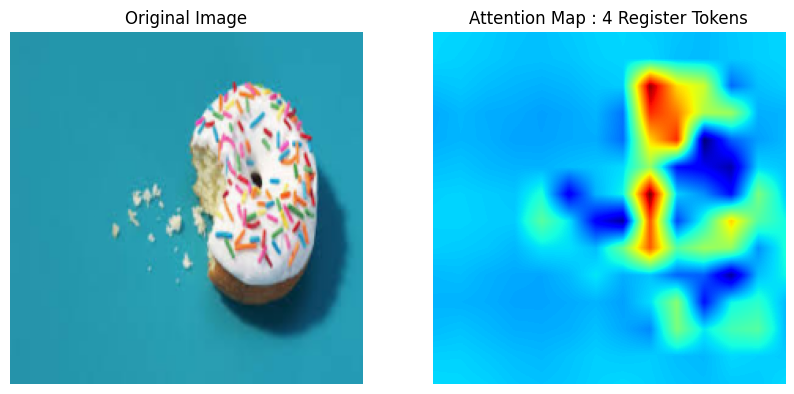

attn_map shape: (197, 197)
cls_attention shape before reshape: (196,)
cls_attention shape after reshape: (14, 14)
cls_attention shape after zoom: (224, 224)


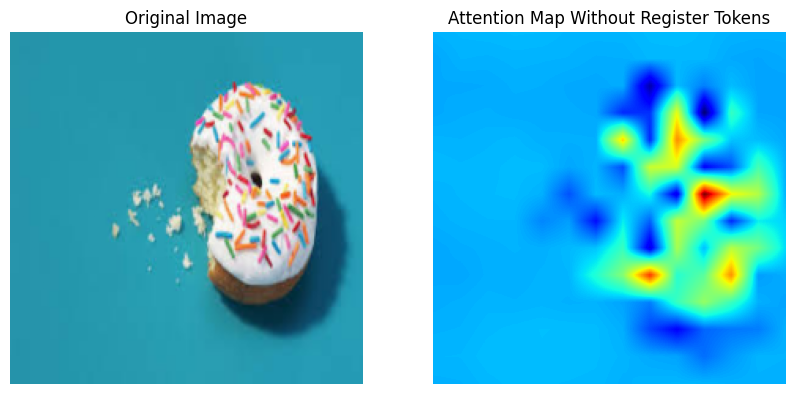

In [13]:
# 데이터 준비
check_attnmap_images, _ = next(iter(train_loader))
check_attnmap_images = check_attnmap_images.to(device)

# 모델을 평가 모드로 설정
model_with_register.eval()
model_without_register.eval()

# Attention 맵 추출
with torch.no_grad():
    _, attn_maps_with_register = model_with_register(check_attnmap_images)
    _, attn_maps_without_register = model_without_register(check_attnmap_images)

print(f"Shape of attn_maps_with_register[0]: {attn_maps_with_register[0].shape}")
print(f"Shape of attn_maps_without_register[0]: {attn_maps_without_register[0].shape}")

visualize_single_attention(attn_maps_with_register[-1], check_attnmap_images[0], head_index=0, num_register_tokens=num_register_tokens)
visualize_single_attention(attn_maps_without_register[-1], check_attnmap_images[0], head_index=0)

## 모델 학습 및 예측

In [14]:
# 4. Loss Function and Optimizer
criterion = nn.CrossEntropyLoss()
optimizer_with_register = Adam(model_with_register.parameters(), lr=0.0002)
optimizer_without_register = Adam(model_without_register.parameters(), lr=0.0002)

# 5. Training Function with `tqdm`
def train_model(model, optimizer):
    model.train()
    total_loss = 0
    correct = 0
    for images, labels in tqdm(train_loader, desc="Training", leave=False):
        images, labels = images.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs, _ = model(images)  # Removed Attention map functionality
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()
        _, predicted = outputs.max(1)
        correct += predicted.eq(labels).sum().item()
    accuracy = correct / len(train_dataset)
    return total_loss / len(train_loader), accuracy

# 6. Validation Function with `tqdm`
def validate_model(model):
    model.eval()
    correct = 0
    with torch.no_grad():
        for images, labels in tqdm(val_loader, desc="Validating", leave=False):
            images, labels = images.to(device), labels.to(device)
            outputs, _ = model(images)  # Removed Attention map functionality
            _, predicted = outputs.max(1)
            correct += predicted.eq(labels).sum().item()
    accuracy = correct / len(val_dataset)
    return accuracy

In [15]:
# 7. Training Loop and Performance Comparison
print(f"With Register Token:\n")
for epoch in range(num_epochs):
    print(f"Epoch {epoch+1}/{num_epochs}")
    # Train both models
    loss_with_register, acc_with_register = train_model(model_with_register, optimizer_with_register)

    # Validate both models
    val_acc_with_register = validate_model(model_with_register)

    # Print results for each epoch
    print(f"epoch {epoch+1} : Loss = {loss_with_register:.4f}, Train Acc = {acc_with_register:.4f}, Val Acc = {val_acc_with_register:.4f}")


print(f"\n\nWith Register Token:\n")
for epoch in range(num_epochs):
    print(f"Epoch {epoch+1}/{num_epochs}")
    # Train both models
    loss_without_register, acc_without_register = train_model(model_without_register, optimizer_without_register)

    # Validate both models
    val_acc_without_register = validate_model(model_without_register)

    # Print results for each epoch
    print(f"epoch {epoch+1} : Loss = {loss_without_register:.4f}, Train Acc = {acc_without_register:.4f}, Val Acc = {val_acc_without_register:.4f}")


With Register Token:

Epoch 1/5


Training:   0%|          | 0/5000 [00:00<?, ?it/s]

/home/user/anaconda3/envs/mycv/lib/python3.9/site-packages/PIL/Image.py:1054: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Validating:   0%|          | 0/1274 [00:00<?, ?it/s]

epoch 1 : Loss = 1.5365, Train Acc = 0.3310, Val Acc = 0.3878
Epoch 2/5


Training:   0%|          | 0/5000 [00:00<?, ?it/s]

Validating:   0%|          | 0/1274 [00:00<?, ?it/s]

epoch 2 : Loss = 1.3707, Train Acc = 0.4192, Val Acc = 0.4435
Epoch 3/5


Training:   0%|          | 0/5000 [00:00<?, ?it/s]

Validating:   0%|          | 0/1274 [00:00<?, ?it/s]

epoch 3 : Loss = 1.3074, Train Acc = 0.4506, Val Acc = 0.3901
Epoch 4/5


Training:   0%|          | 0/5000 [00:00<?, ?it/s]

Validating:   0%|          | 0/1274 [00:00<?, ?it/s]

epoch 4 : Loss = 1.2712, Train Acc = 0.4662, Val Acc = 0.4474
Epoch 5/5


Training:   0%|          | 0/5000 [00:00<?, ?it/s]

Validating:   0%|          | 0/1274 [00:00<?, ?it/s]

epoch 5 : Loss = 1.2319, Train Acc = 0.4884, Val Acc = 0.4631


With Register Token:

Epoch 1/5


Training:   0%|          | 0/5000 [00:00<?, ?it/s]

Validating:   0%|          | 0/1274 [00:00<?, ?it/s]

epoch 1 : Loss = 1.5269, Train Acc = 0.3262, Val Acc = 0.3980
Epoch 2/5


Training:   0%|          | 0/5000 [00:00<?, ?it/s]

Validating:   0%|          | 0/1274 [00:00<?, ?it/s]

epoch 2 : Loss = 1.3850, Train Acc = 0.4010, Val Acc = 0.4176
Epoch 3/5


Training:   0%|          | 0/5000 [00:00<?, ?it/s]

Validating:   0%|          | 0/1274 [00:00<?, ?it/s]

epoch 3 : Loss = 1.3423, Train Acc = 0.4228, Val Acc = 0.3885
Epoch 4/5


Training:   0%|          | 0/5000 [00:00<?, ?it/s]

Validating:   0%|          | 0/1274 [00:00<?, ?it/s]

epoch 4 : Loss = 1.3122, Train Acc = 0.4454, Val Acc = 0.4686
Epoch 5/5


Training:   0%|          | 0/5000 [00:00<?, ?it/s]

Validating:   0%|          | 0/1274 [00:00<?, ?it/s]

epoch 5 : Loss = 1.2664, Train Acc = 0.4754, Val Acc = 0.4772


## 모델 평가

In [16]:
# Test Function
def test_model(model):
    model.eval()
    correct = 0
    with torch.no_grad():
        for images, labels in tqdm(test_loader, desc="Testing", leave=False):
            images, labels = images.to(device), labels.to(device)
            outputs, _ = model(images)  # Removed Attention map functionality
            _, predicted = outputs.max(1)
            correct += predicted.eq(labels).sum().item()
    accuracy = correct / len(test_dataset)
    return accuracy

test_acc_with_register = test_model(model_with_register)
test_acc_without_register = test_model(model_without_register)
print(f"With Register Token - Final Test Accuracy: {test_acc_with_register:.4f}")
print(f"Without Register Token - Final Test Accuracy: {test_acc_without_register:.4f}")

Testing:   0%|          | 0/1274 [00:00<?, ?it/s]

Testing:   0%|          | 0/1274 [00:00<?, ?it/s]

With Register Token - Final Test Accuracy: 0.4600
Without Register Token - Final Test Accuracy: 0.4796


## (학습 후) Attention map 그리기

Shape of attn_maps_with_register[0]: torch.Size([1, 8, 201, 201])
Shape of attn_maps_without_register[0]: torch.Size([1, 8, 197, 197])
attn_map shape: (201, 201)
cls_attention shape before reshape: (196,)
cls_attention shape after reshape: (14, 14)
cls_attention shape after zoom: (224, 224)


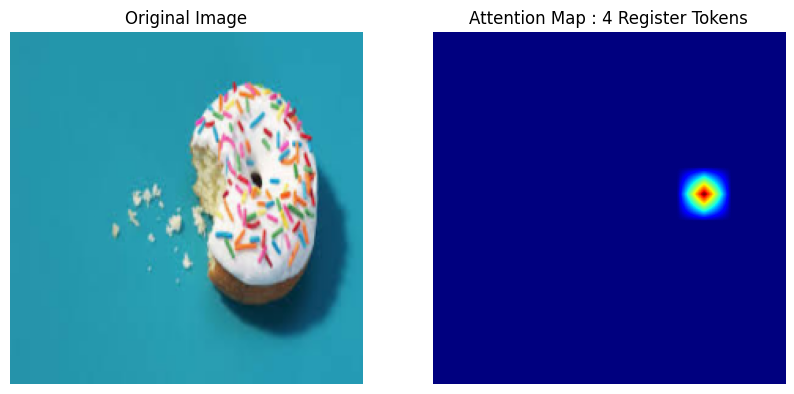

attn_map shape: (197, 197)
cls_attention shape before reshape: (196,)
cls_attention shape after reshape: (14, 14)
cls_attention shape after zoom: (224, 224)


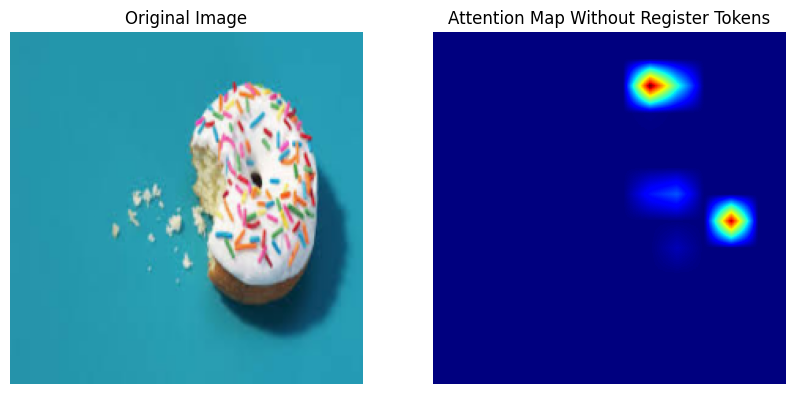

In [17]:
# 모델을 평가 모드로 설정
model_with_register.eval()
model_without_register.eval()

# Attention 맵 추출
with torch.no_grad():
    _, attn_maps_with_register = model_with_register(check_attnmap_images)
    _, attn_maps_without_register = model_without_register(check_attnmap_images)

print(f"Shape of attn_maps_with_register[0]: {attn_maps_with_register[0].shape}")
print(f"Shape of attn_maps_without_register[0]: {attn_maps_without_register[0].shape}")

visualize_single_attention(attn_maps_with_register[-1], check_attnmap_images[0], head_index=0, num_register_tokens=num_register_tokens)
visualize_single_attention(attn_maps_without_register[-1], check_attnmap_images[0], head_index=0)

## 선형프로빙 

In [18]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score
import seaborn as sns
from collections import Counter
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from matplotlib.patches import Patch

In [43]:
def ensure_class_diversity(indices, patch_labels, grid_size):
    """
    패치 인덱스에서 최소 두 개 이상의 클래스를 포함하도록 샘플링.
    """
    unique_classes = np.unique(patch_labels[indices])
    if len(unique_classes) < 2:
        # 추가 클래스가 필요하면 전체 데이터에서 새 샘플 선택
        additional_indices = []
        for cls in np.unique(patch_labels):
            cls_indices = np.where(patch_labels == cls)[0]
            if len(cls_indices) > 0:
                additional_indices.extend(np.random.choice(cls_indices, size=min(grid_size // 2, len(cls_indices)), replace=False))
        indices = np.array(additional_indices)
    return indices

def get_outlier_and_normal_patches(patch_norms, patch_labels, threshold, grid_size):
    """
    L2 norm 기준으로 아웃라이어와 정상 패치를 구분하고, 클래스 다양성을 보장.
    """
    # L2 norm 기준으로 아웃라이어와 정상 패치 구분
    top_indices = np.where(patch_norms > threshold)[0]  # L2 norm 초과 패치
    normal_indices = np.where(patch_norms <= threshold)[0]  # L2 norm 이하 패치

    # 클래스 다양성을 보장
    top_indices = ensure_class_diversity(top_indices, patch_labels, grid_size)
    normal_indices = ensure_class_diversity(normal_indices, patch_labels, grid_size)

    return top_indices, normal_indices

def multitask_linear_probe(model, images, labels, threshold=150, grid_size=14):
    """
    멀티태스킹 학습: 아웃라이어 패치와 일반 패치를 동시에 학습하며, 두 그룹의 성능을 독립적으로 계산.
    """
    model.eval()

    all_patch_embeddings = []
    all_patch_labels = []
    all_patch_groups = []  # 아웃라이어/정상 패치를 구분하는 그룹 레이블

    # 이미지별 인덱스 저장
    image_top_indices = []  # 각 이미지의 아웃라이어 패치 인덱스
    image_normal_indices = []  # 각 이미지의 정상 패치 인덱스

    for idx in range(len(images)):  # 각 이미지 처리
        with torch.no_grad():
            patch_embeddings = model.get_patch_embeddings(images[idx:idx+1])  # [1, Patches, Dim]
            patch_norms = torch.norm(patch_embeddings, dim=-1).view(-1).cpu().numpy()  # L2 norm 계산

        num_patches = patch_embeddings.shape[1]
        patch_embeddings = patch_embeddings.view(-1, patch_embeddings.shape[-1]).cpu().numpy()  # [Patches, Dim]
        patch_labels = np.array([labels[idx].item()] * num_patches)  # [Patches]

        # 아웃라이어와 정상 패치 구분
        top_indices, normal_indices = get_outlier_and_normal_patches(patch_norms, patch_labels, threshold, grid_size)

        # 그룹 레이블: 아웃라이어=1, 정상=0
        patch_groups = np.zeros(num_patches)
        patch_groups[top_indices] = 1

        # 이미지별 인덱스 저장
        image_top_indices.append(top_indices.tolist())
        image_normal_indices.append(normal_indices.tolist())

        # 데이터 누적
        all_patch_embeddings.append(patch_embeddings)
        all_patch_labels.append(patch_labels)
        all_patch_groups.append(patch_groups)

    # Flatten 데이터 생성
    all_patch_embeddings = np.vstack(all_patch_embeddings)
    all_patch_labels = np.hstack(all_patch_labels)
    all_patch_groups = np.hstack(all_patch_groups)  # 그룹 정보

    # 멀티태스킹 선형 분류기 학습
    clf = LogisticRegression(max_iter=1000, class_weight="balanced")
    clf.fit(all_patch_embeddings, all_patch_groups)  # 아웃라이어/정상 그룹을 학습

    # 전체 확률 계산
    all_patch_probs = clf.predict_proba(all_patch_embeddings)[:, 1]  # 아웃라이어 확률

    # 성능 평가
    outlier_indices = np.where(all_patch_groups == 1)[0]
    normal_indices = np.where(all_patch_groups == 0)[0]

    outlier_predictions = clf.predict(all_patch_embeddings[outlier_indices])
    normal_predictions = clf.predict(all_patch_embeddings[normal_indices])

    outlier_metrics = {
        "accuracy": accuracy_score(all_patch_groups[outlier_indices], outlier_predictions),
        "precision": precision_score(all_patch_groups[outlier_indices], outlier_predictions, zero_division=1),
        "recall": recall_score(all_patch_groups[outlier_indices], outlier_predictions, zero_division=1),
        "f1_score": f1_score(all_patch_groups[outlier_indices], outlier_predictions, zero_division=1),
    }

    normal_metrics = {
        "accuracy": accuracy_score(all_patch_groups[normal_indices], normal_predictions),
        "precision": precision_score(all_patch_groups[normal_indices], normal_predictions, zero_division=1),
        "recall": recall_score(all_patch_groups[normal_indices], normal_predictions, zero_division=1),
        "f1_score": f1_score(all_patch_groups[normal_indices], normal_predictions, zero_division=1),
    }

    return {
        "outlier": outlier_metrics,
        "normal": normal_metrics,
        "image_top_indices": image_top_indices,  # 각 이미지의 아웃라이어 패치 인덱스
        "image_normal_indices": image_normal_indices,  # 각 이미지의 정상 패치 인덱스
        "all_patch_probs": all_patch_probs,  # 전체 패치 확률
    }

In [44]:
def visualize_patch_predictions(image, top_indices, all_patch_probs, num_patches):
    """
    패치 성능을 원래 이미지에 시각화.
    """
    grid_size = int(np.sqrt(num_patches))
    if grid_size ** 2 != num_patches:
        raise ValueError(f"Grid size mismatch: {grid_size}x{grid_size} != {num_patches}")

    # 모든 패치 확률 초기화
    patch_probs = all_patch_probs[:num_patches].reshape(grid_size, grid_size)

    # 레이아웃 구성
    fig = plt.figure(figsize=(14, 7))  # 전체 그림 크기 유지
    gs = GridSpec(2, 2, figure=fig, height_ratios=[12, 1], width_ratios=[1, 1])  # 이미지 크기 비율 확대

    # 왼쪽: 원본 이미지
    ax1 = fig.add_subplot(gs[0, 0])
    ax1.imshow(image.permute(1, 2, 0).cpu().numpy())
    ax1.axis("off")  # 축 제거

    # 오른쪽: 패치 시각화 이미지
    ax2 = fig.add_subplot(gs[0, 1])
    patch_size = image.shape[1] // grid_size  # 패치 크기 계산

    ax2.imshow(image.permute(1, 2, 0).cpu().numpy())  # 배경 이미지
    for i in range(grid_size):
        for j in range(grid_size):
            patch_index = i * grid_size + j
            prob = patch_probs[i, j]

            # 패치 내부는 부드러운 회색으로 표시
            face_color = (1 - prob, 1 - prob, 1 - prob, 0.7)  # 회색 톤 + 투명도 0.7
            rect = plt.Rectangle(
                (j * patch_size, i * patch_size),
                patch_size,
                patch_size,
                linewidth=3,  # 적당히 두꺼운 테두리
                edgecolor='red' if patch_index in top_indices else 'none',  # 아웃라이어는 빨간 테두리
                facecolor=face_color
            )
            ax2.add_patch(rect)

            # 텍스트 추가 (확률값 표시)
            text_color = "white" if prob > 0.5 else "black"
            ax2.text(
                j * patch_size + patch_size / 2,
                i * patch_size + patch_size / 2,
                f"{prob:.2f}",
                color=text_color,
                ha="center",
                va="center",
                fontsize=11,  # 텍스트 크기
                weight="light"
            )
    ax2.axis("off")  # 축 제거

    # 하단: 범례 추가
    ax_legend = fig.add_subplot(gs[1, :])
    ax_legend.axis("off")
    legend_elements = [
        Patch(facecolor=(0.5, 0.5, 0.5, 0.6), edgecolor='none', label='All Patches (Gray)'),
        Patch(facecolor='none', edgecolor='red', linewidth=2, label='Outlier Patch (Red Border)'),
    ]
    ax_legend.legend(handles=legend_elements, loc='center', ncol=2, frameon=False, fontsize=14)  # 범례 글씨 크기 줄임

    plt.tight_layout()
    plt.show()


In [45]:
def prepare_images_and_labels(loader, device, target_num_images=10):
    """
    다양한 이미지를 가져와 라벨 다양성을 보장.
    """
    images, labels = [], []
    while len(images) < target_num_images:
        batch_images, batch_labels = next(iter(loader))
        images.append(batch_images)
        labels.append(batch_labels)
    
    # 이미지와 라벨 병합
    images = torch.cat(images[:target_num_images], dim=0).to(device)
    labels = torch.cat(labels[:target_num_images], dim=0).to(device)

    return images, labels


== Linear Probing Results ==

With Register Tokens
  Outlier Patch - Accuracy: 0.8143, Precision: 1.0000, Recall: 0.8143, F1 Score: 0.8976
  Normal Patch - Accuracy: 0.7947, Precision: 0.0000, Recall: 1.0000, F1 Score: 0.0000

Without Register Tokens
  Outlier Patch - Accuracy: 0.7714, Precision: 1.0000, Recall: 0.7714, F1 Score: 0.8710
  Normal Patch - Accuracy: 0.7709, Precision: 0.0000, Recall: 1.0000, F1 Score: 0.0000


== Visualizing Patch Predictions ==

Visualizing image 1/10 for 'With Register Tokens':


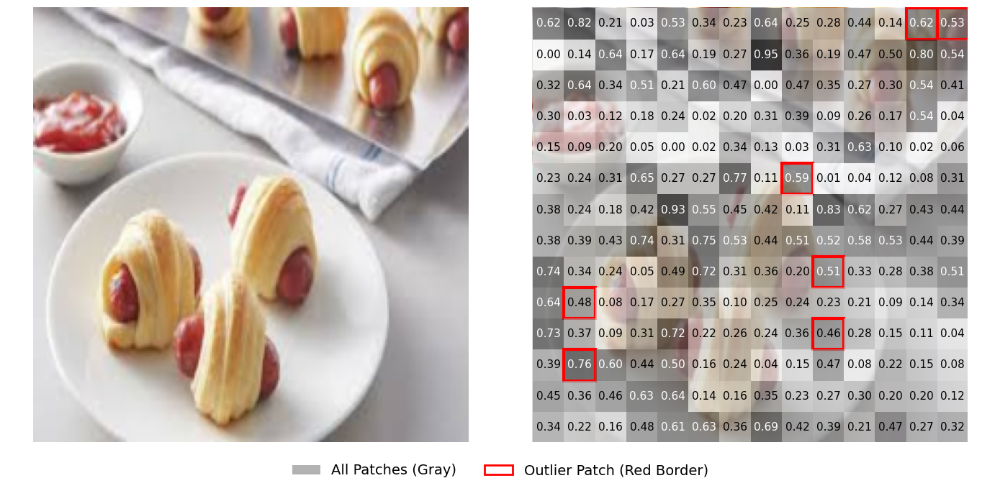

Visualizing image 1/10 for 'Without Register Tokens':


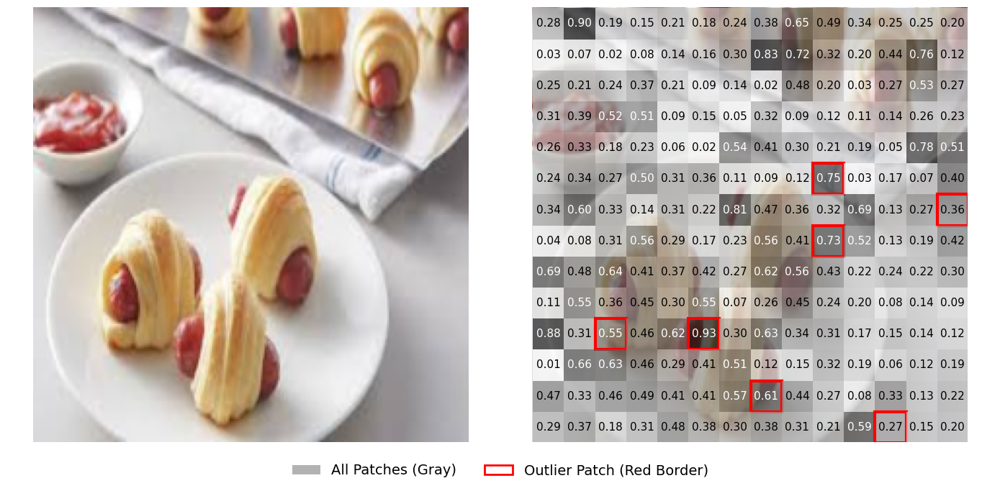

Visualizing image 2/10 for 'With Register Tokens':


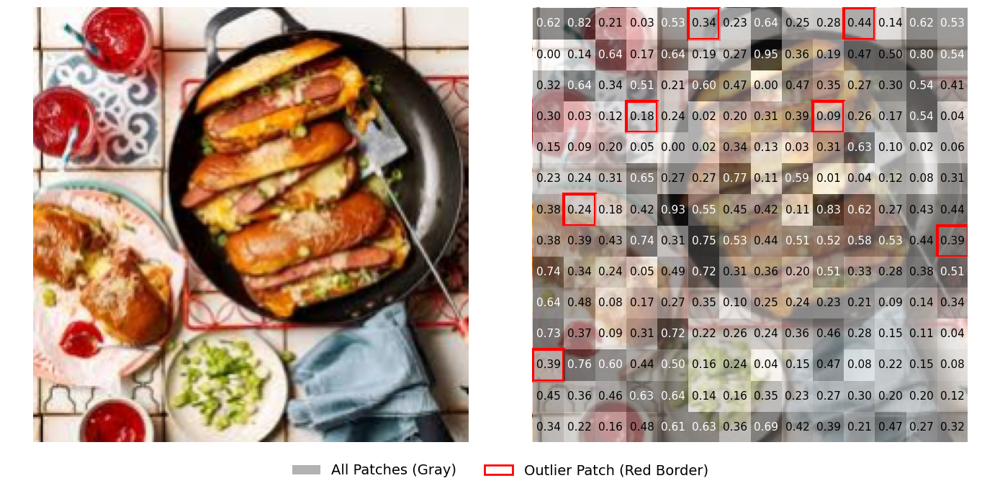

Visualizing image 2/10 for 'Without Register Tokens':


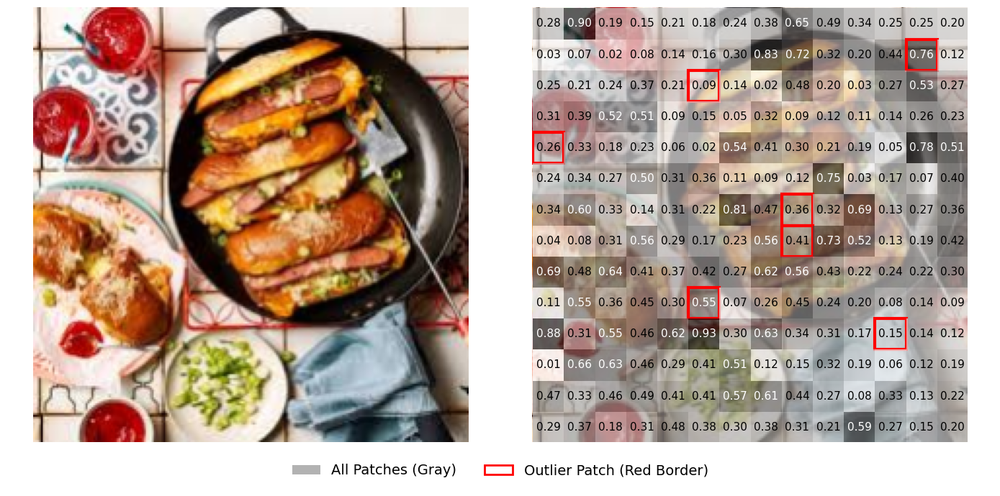

Visualizing image 3/10 for 'With Register Tokens':


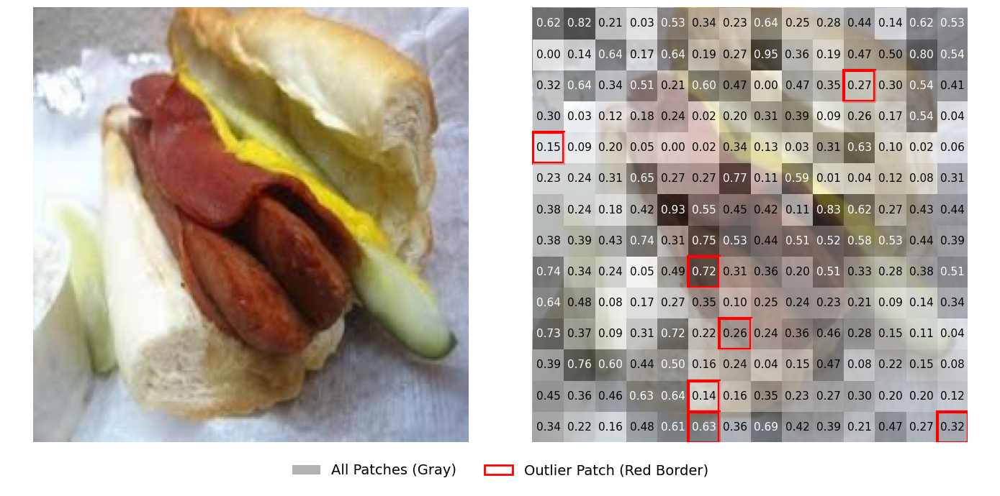

Visualizing image 3/10 for 'Without Register Tokens':


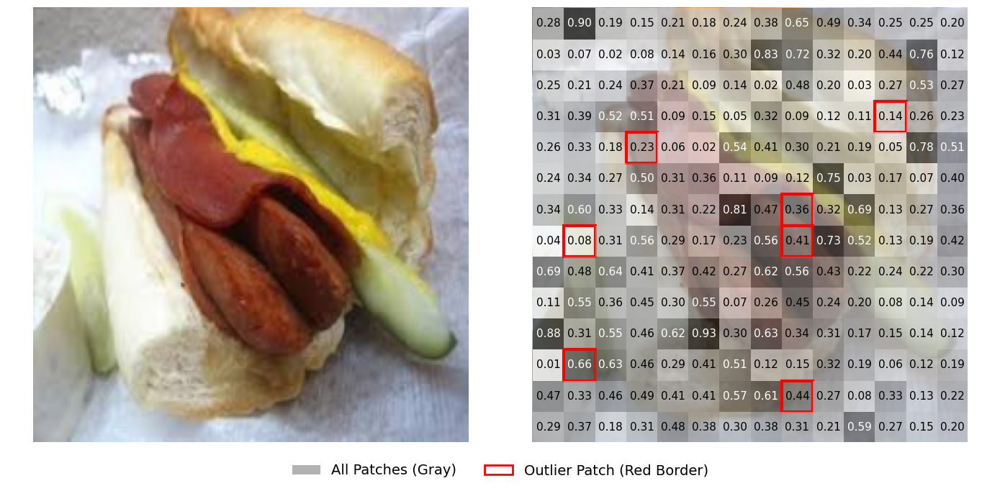

Visualizing image 4/10 for 'With Register Tokens':


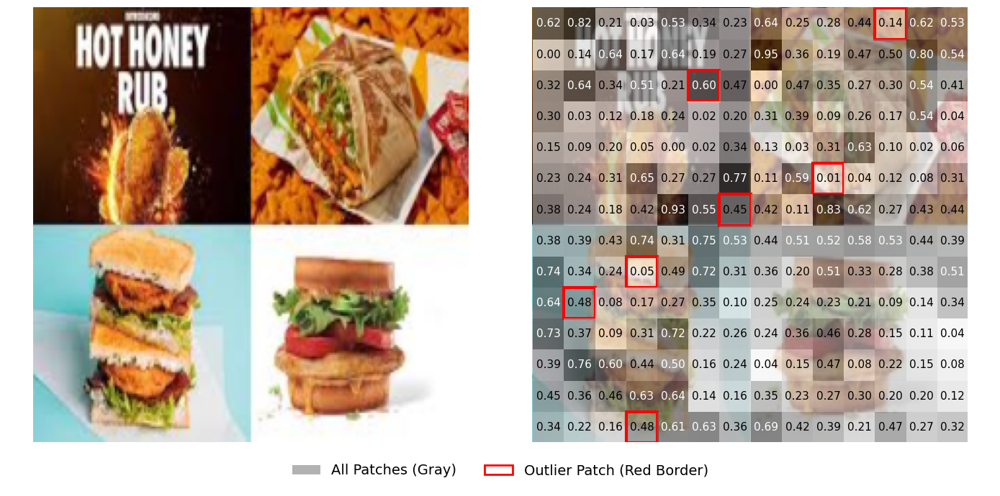

Visualizing image 4/10 for 'Without Register Tokens':


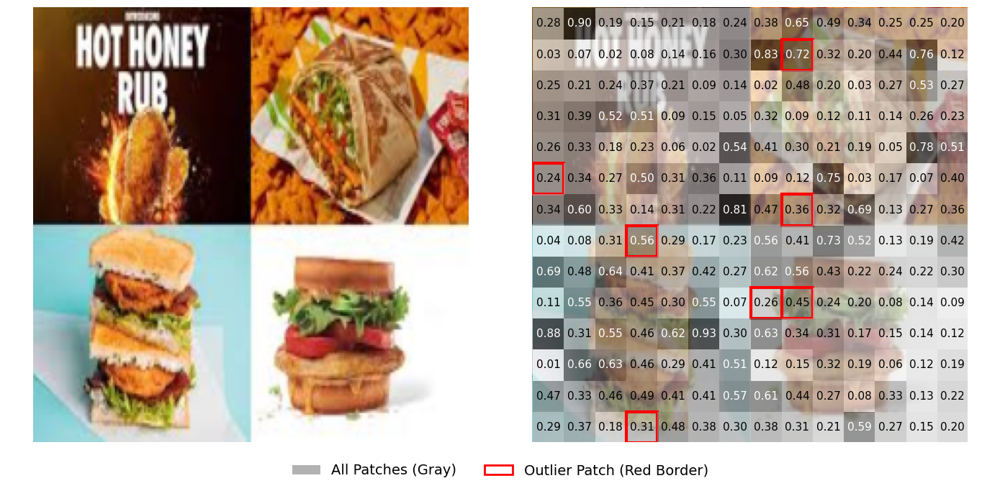

Visualizing image 5/10 for 'With Register Tokens':


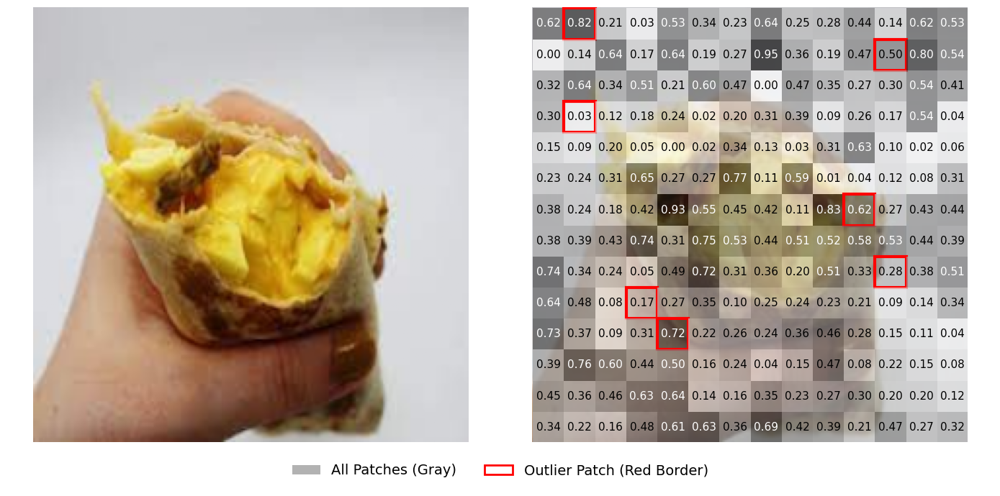

Visualizing image 5/10 for 'Without Register Tokens':


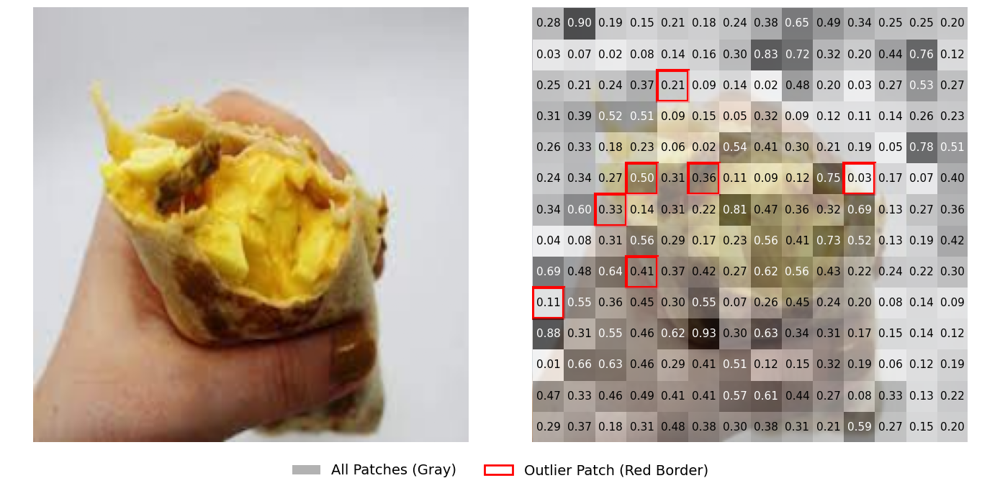

Visualizing image 6/10 for 'With Register Tokens':


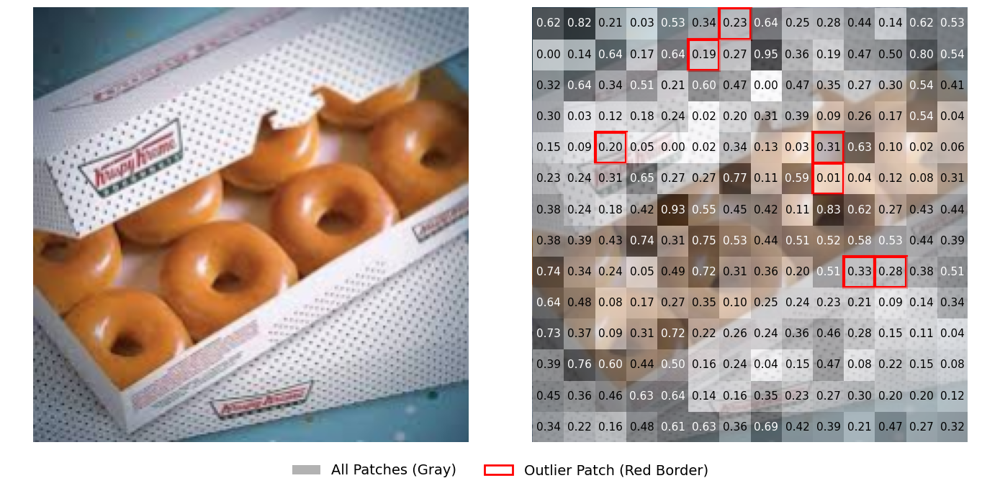

Visualizing image 6/10 for 'Without Register Tokens':


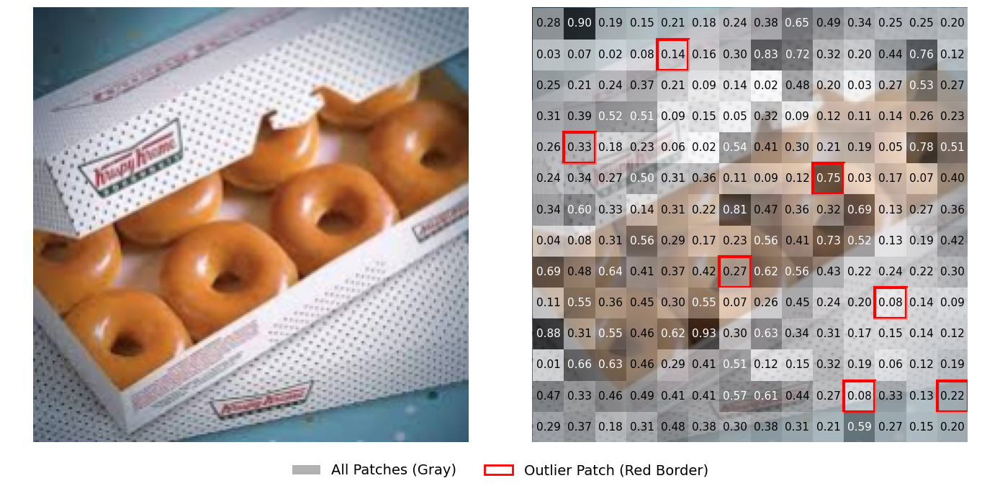

Visualizing image 7/10 for 'With Register Tokens':


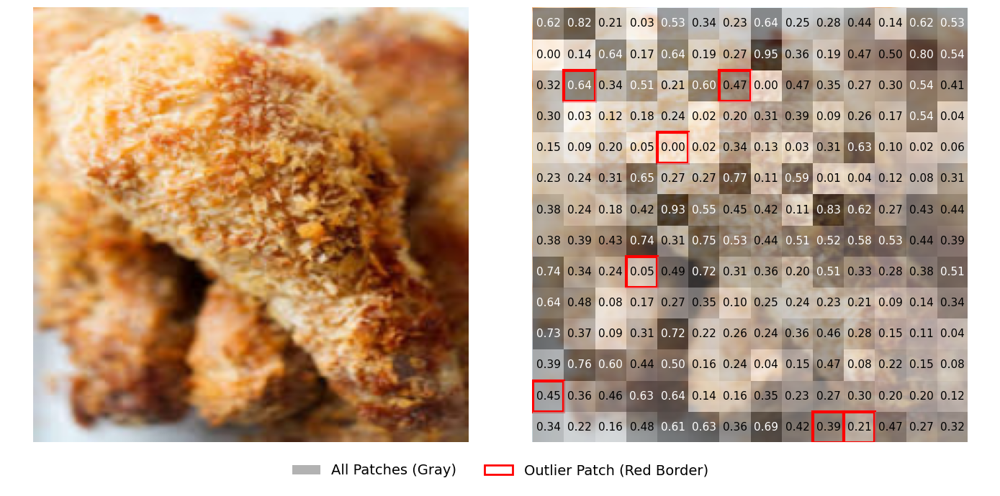

Visualizing image 7/10 for 'Without Register Tokens':


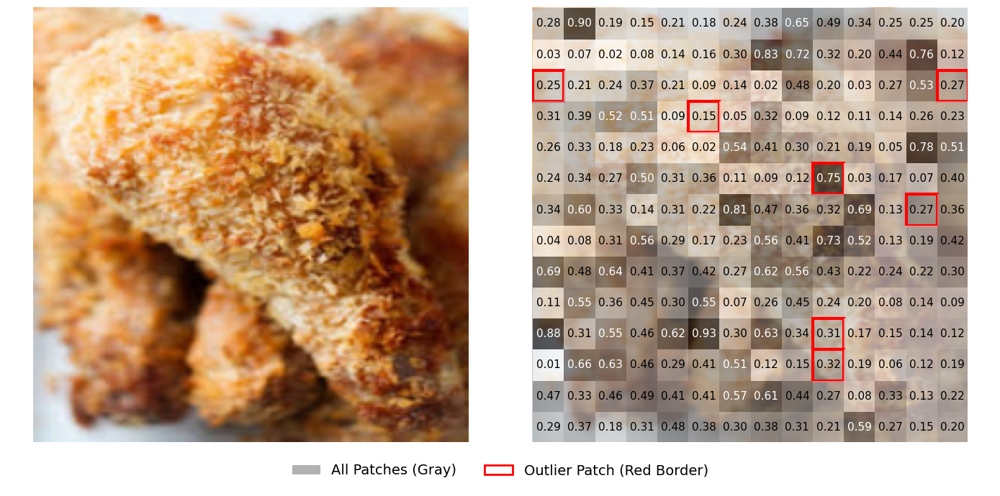

Visualizing image 8/10 for 'With Register Tokens':


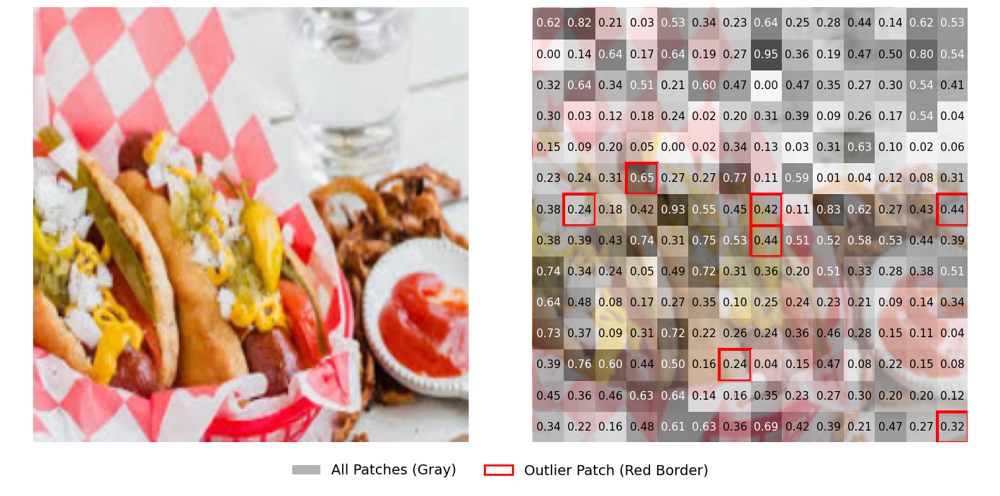

Visualizing image 8/10 for 'Without Register Tokens':


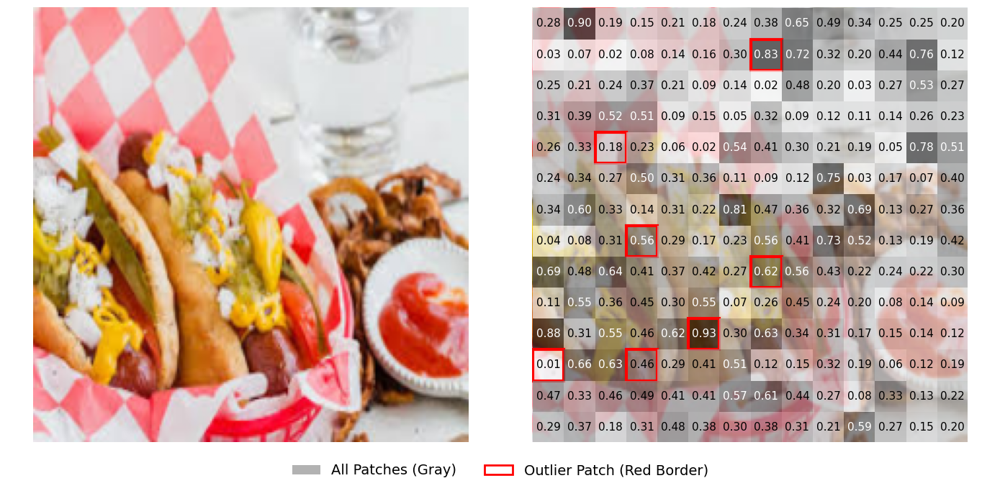

Visualizing image 9/10 for 'With Register Tokens':


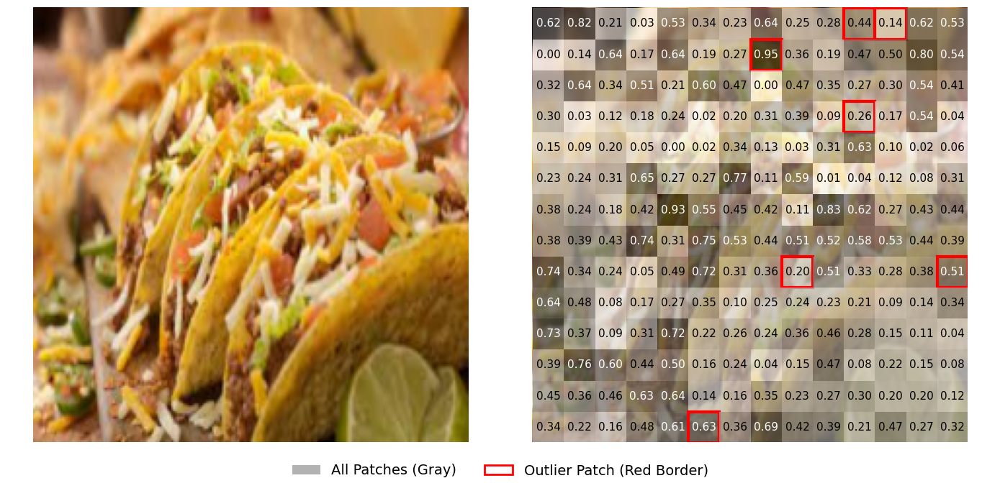

Visualizing image 9/10 for 'Without Register Tokens':


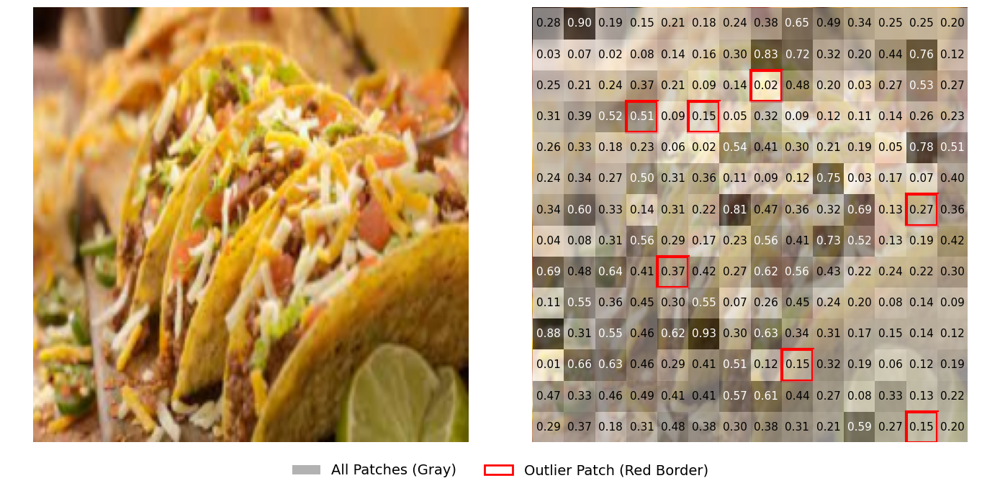

Visualizing image 10/10 for 'With Register Tokens':


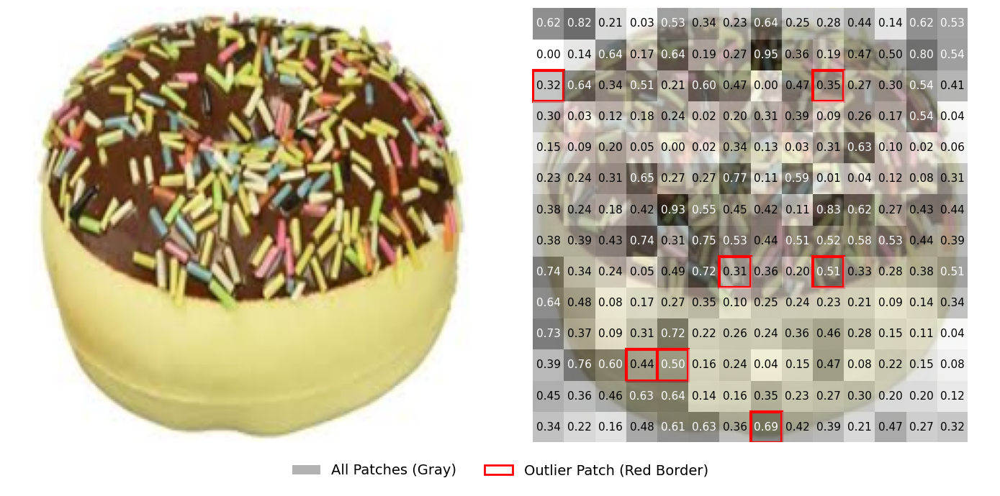

Visualizing image 10/10 for 'Without Register Tokens':


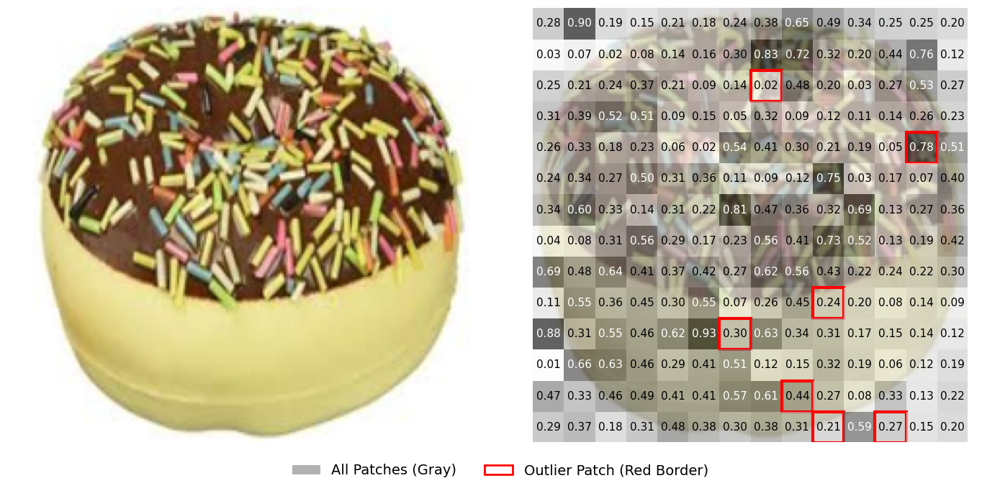

In [46]:
# 이미지 선택 및 어텐션 맵 추출
images, labels = prepare_images_and_labels(train_loader, device, target_num_images=10)

# 선형 프로빙 수행
results_with = multitask_linear_probe(model_with_register, images, labels, threshold=150, grid_size=14)
results_without = multitask_linear_probe(model_without_register, images, labels, threshold=150, grid_size=14)

print("\n== Linear Probing Results ==")

print("\nWith Register Tokens")
print(f"  Outlier Patch - Accuracy: {results_with['outlier']['accuracy']:.4f}, Precision: {results_with['outlier']['precision']:.4f}, Recall: {results_with['outlier']['recall']:.4f}, F1 Score: {results_with['outlier']['f1_score']:.4f}")
print(f"  Normal Patch - Accuracy: {results_with['normal']['accuracy']:.4f}, Precision: {results_with['normal']['precision']:.4f}, Recall: {results_with['normal']['recall']:.4f}, F1 Score: {results_with['normal']['f1_score']:.4f}")

print("\nWithout Register Tokens")
print(f"  Outlier Patch - Accuracy: {results_without['outlier']['accuracy']:.4f}, Precision: {results_without['outlier']['precision']:.4f}, Recall: {results_without['outlier']['recall']:.4f}, F1 Score: {results_without['outlier']['f1_score']:.4f}")
print(f"  Normal Patch - Accuracy: {results_without['normal']['accuracy']:.4f}, Precision: {results_without['normal']['precision']:.4f}, Recall: {results_without['normal']['recall']:.4f}, F1 Score: {results_without['normal']['f1_score']:.4f}")

print("\n\n== Visualizing Patch Predictions ==\n")

for idx in range(10):  # 10개 이미지 시각화
    print(f"Visualizing image {idx + 1}/{len(images)} for 'With Register Tokens':")
    visualize_patch_predictions(images[idx], results_with["image_top_indices"][idx], results_with["all_patch_probs"], num_patches=196)

    print(f"Visualizing image {idx + 1}/{len(images)} for 'Without Register Tokens':")
    visualize_patch_predictions(images[idx], results_without["image_top_indices"][idx], results_without["all_patch_probs"], num_patches=196)
